In [1]:
from lsst.daf.butler import Butler
import numpy as np
import os
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "3"
import tensorflow as tf
import multiprocessing
from matplotlib import pyplot as plt
import matplotlib.patches as patches
import cv2

180


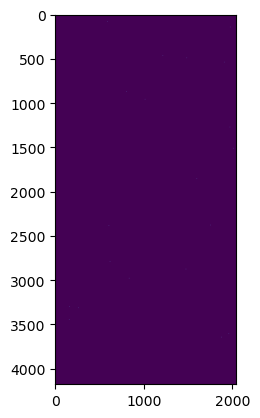

In [2]:
repo = "/epyc/ssd/users/kmrakovc/DATA/rc2_subset/SMALL_HSC/"
output_coll = "u/kmrakovc/single_frame_injection_01"
butler = Butler(repo)
catalog_ref = list(butler.registry.queryDatasets("injected_postISRCCD_catalog", 
                                                     collections=output_coll, 
                                                     instrument='HSC'))[0]
exp_ref = list(butler.registry.queryDatasets("injected_calexp", 
                                             collections=output_coll, 
                                             instrument='HSC'))[0]
injected_calexp=butler.get("injected_calexp",
                               dataId=exp_ref.dataId,
                               collections=output_coll)
        
calexp=butler.get("calexp",
                      dataId=exp_ref.dataId,
                      collections=output_coll)
        
catalog = butler.get("injected_postISRCCD_catalog",
                         dataId=catalog_ref.dataId,
                         collections=output_coll)

mask_name = 'INJECTED_CORE'
bit_global=injected_calexp.mask.getPlaneBitMask(mask_name)
diffim_CR_mask=np.where(np.bitwise_and(injected_calexp.mask.array, bit_global), True, False)
plt.imshow(diffim_CR_mask)
print (diffim_CR_mask.sum())

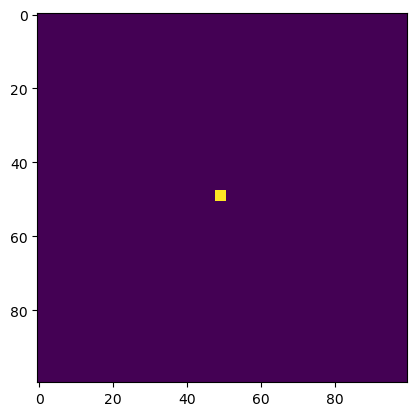

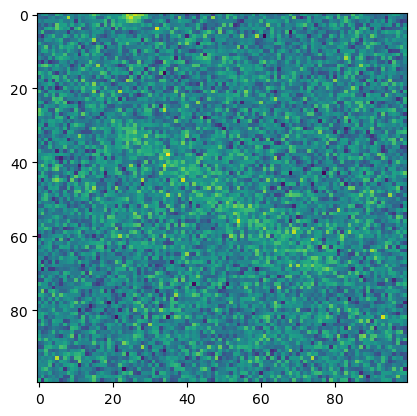

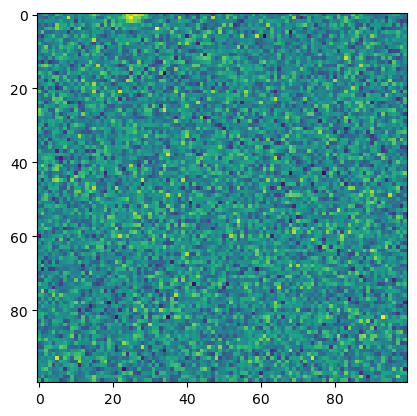

In [47]:
x,y = np.where(diffim_CR_mask)
x=x[8]
y=y[8]
plt.imshow(diffim_CR_mask[x-50:x+50, y-50:y+50])
plt.show()
plt.imshow(injected_calexp.image.array[x-50:x+50, y-50:y+50])
plt.show()
plt.imshow(calexp.image.array[x-50:x+50, y-50:y+50])

In [7]:
def split(arr, nrows, ncols):
    """
    Return an array of shape (n, nrows, ncols) where
    n * nrows * ncols = arr.size

    If arr is a 2D array, the returned array should look like n subblocks with
    each subblock preserving the "physical" layout of arr.
    """
    if arr.shape[0] % nrows != 0:
        arr = np.vstack([arr, np.zeros(shape = (nrows -(arr.shape[0]%nrows), arr.shape[1]))])
    if arr.shape[1] % ncols != 0:
        arr = np.hstack([arr, np.zeros(shape = (arr.shape[0], ncols-(arr.shape[1]%ncols)))])
    return (arr.reshape(arr.shape[0]//nrows, nrows, -1, ncols).swapaxes(1,2).reshape(-1, nrows, ncols))

def get_mask_layer (calexp, mask_name):
    bit_global=calexp.mask.getPlaneBitMask(mask_name)
    return np.where(np.bitwise_and(calexp.mask.array, bit_global), True, False)

def depthfirstsearch(img, root_j, root_i):
    height = img.shape[0]
    width = img.shape[1]
    mask = np.zeros([height, width])
    try:
        _ = iter(root_j)
    except TypeError:
        todo = [(int(root_j),int(root_i))]
    else:
        assert len(root_j)==len(root_i)
        todo = []
        for k in range(len(root_j)):
            todo += [(int(root_j[k]),int(root_i[k]))]
    visited_pixels = set()
    while todo:
        j,i = todo.pop()
        if (0 <= j < height) and (0 <= i < width) and (img[j,i] > 0):
            visited_pixels.add((j, i))
            mask[j,i] = 1
            if not (j+1,i) in visited_pixels:
                todo += [(j+1,i)]
            if not (j-1,i) in visited_pixels:
                todo += [(j-1,i)]
            if not (j,i+1) in visited_pixels:
                todo += [(j,i+1)]
            if not (j,i-1) in visited_pixels:
                todo += [(j,i-1)]
            if not (j-1,i-1) in visited_pixels:
                todo += [(j-1,i-1)]
            if not (j+1,i+1) in visited_pixels:
                todo += [(j+1,i+1)]
    return mask

def draw_one_line (mask, origin, angle, length, line_thickness=2):
    x0=origin[0]
    y0=origin[1]
    x_size = length*np.cos((np.pi/180)*angle)
    y_size = length*np.sin((np.pi/180)*angle)
    x1 = x0-x_size/2
    y1 = y0-y_size/2
    x0 = x0+x_size/2
    y0 = y0+y_size/2
    return cv2.line(mask,(int(x0),int(y0)),(int(x1),int(y1)), 1, thickness=2)

def draw_mask_lines (catalog, calexp):
    mask = np.zeros(calexp.image.array.shape)
    for k in range (len(catalog)):
        origin = calexp.getWcs().skyToPixelArray(np.array([catalog[k]["ra"]]), np.array([catalog[k]["dec"]]), degrees=True)
        angle = catalog[k]["beta"]
        length = catalog[k]["trail_length"]
        mask = draw_one_line (mask, origin, angle, length)
    return mask
    

def one_visit_IO (exp_ref, cat_ref, butler, output_coll, shape=(512, 512)):
    injected_calexp=butler.get("injected_calexp",
                               dataId=exp_ref.dataId,
                               collections=output_coll)
        
    calexp=butler.get("calexp",
                      dataId=exp_ref.dataId,
                      collections=output_coll)
        
    catalog = butler.get("injected_postISRCCD_catalog",
                         dataId=cat_ref.dataId,
                         collections=output_coll)
        
    diff_mask = injected_calexp.image.array-calexp.image.array
    #x_root=[injected_calexp.getWcs().skyToPixelArray(np.array([k["ra"]]), np.array([k["dec"]]), degrees=True)[1][0] for k in catalog]
    #y_root=[injected_calexp.getWcs().skyToPixelArray(np.array([k["ra"]]), np.array([k["dec"]]), degrees=True)[0][0] for k in catalog]
    #mask = dfs (diff_mask>5*diff_mask.std(), x_root, y_root)
    #mask = get_mask_layer(injected_calexp, 'INJECTED_CORE')
    mask = draw_mask_lines(catalog, injected_calexp)
    split_injected_calexp = split (injected_calexp.image.array, shape[0], shape[1])
    split_mask = split (mask, shape[0], shape[1])
    return split_injected_calexp, split_mask
    

def generate_NN_inputs(repo, output_coll, shape=(512, 512), parallelize=True):             
    butler = Butler(repo)
    catalog_ref = list(butler.registry.queryDatasets("injected_postISRCCD_catalog", 
                                                     collections=output_coll, 
                                                     instrument='HSC'))
    ref = list(butler.registry.queryDatasets("injected_calexp", 
                                             collections=output_coll, 
                                             instrument='HSC'))
    if parallelize:
        data_ref = [(ref[i], catalog_ref[i], butler, output_coll, shape) for i in range(len(ref))]
        pool = multiprocessing.Pool(os.cpu_count()-1)
        a = pool.starmap(one_visit_IO, data_ref)
        pool.close()
        pool.join()
        inputs = [inp[0] for inp in a]
        outputs = [inp[1] for inp in a]
    else:
        inputs = []
        outputs = []
        print("\r",0, "/", len(ref), end="")
        for i in range(len(ref)):
            inp, outp = one_visit_IO(ref[i], catalog_ref[i], butler, output_coll, shape)
            inputs.append(inp)
            outputs.append(outp)
            print("\r",i, "/", len(ref), end="")
    return np.concatenate(inputs), np.concatenate(outputs)

def npy_to_tfrecords(inputs, labels, filename_train, filename_test):
    #inputs = inputs.astype(float)
    #labels = labels.astype(np.int64)
    i=0
    index = np.arange(0, inputs.shape[0])
    np.random.shuffle(index)
    index = index[:int(inputs.shape[0]*0.25)]
    with tf.io.TFRecordWriter(filename_train) as writer_train:
        with tf.io.TFRecordWriter(filename_test) as writer_test:
            for X, y in zip(inputs, labels):
                i+=1
                print("\r",i, "/", inputs.shape[0], end="")
                # Feature contains a map of string to feature proto objects
                feature = {}
                feature['X'] = tf.train.Feature(float_list=tf.train.FloatList(value=X.flatten()))
                feature['y'] = tf.train.Feature(int64_list=tf.train.Int64List(value=y.flatten()))

                # Construct the Example proto object
                example = tf.train.Example(features=tf.train.Features(feature=feature))

                # Serialize the example to a string
                serialized = example.SerializeToString()

                # write the serialized objec to the disk
                if i in index:
                    writer_test.write(serialized)
                else:
                    writer_train.write(serialized)

REPO = "/epyc/ssd/users/kmrakovc/DATA/rc2_subset/SMALL_HSC/"
OUTPUT_COLL = "u/kmrakovc/single_frame_injection_01"    
x,y = generate_NN_inputs(REPO, OUTPUT_COLL, shape=(128,128))
x = x[:,:,:,np.newaxis]
y = y[:,:,:,np.newaxis].astype(int)
npy_to_tfrecords(x, y, 'images_train_core.tfrecord', 'images_test_core.tfrecord')
del x
del y

 123552 / 123552

In [9]:
def encoder_mini_block(inputs, n_filters=32, activation="relu", dropout_prob=0.3, max_pooling=True, name=""):
    conv = tf.keras.layers.Conv2D(n_filters, 
                                  3,  # filter size
                                  activation=activation,
                                  padding='same',
                                  kernel_initializer='HeNormal',
                                  name = "eblock"+name+"conv1")(inputs)
    conv = tf.keras.layers.Conv2D(n_filters, 
                                  3,  # filter size
                                  activation=activation,
                                  padding='same',
                                  kernel_initializer='HeNormal',
                                  name = "eblock"+name+"conv2")(conv)
  
    conv = tf.keras.layers.BatchNormalization(name = "eblock"+name+"norm")(conv, training=False)    
    if dropout_prob > 0:     
        conv = tf.keras.layers.Dropout(dropout_prob, name = "eblock"+name+"drop")(conv)
    if max_pooling:
        next_layer = tf.keras.layers.MaxPooling2D(pool_size = (2,2), name = "eblock"+name+"pool")(conv)    
    else:
        next_layer = conv
    skip_connection = conv    
    return next_layer, skip_connection

def decoder_mini_block(prev_layer_input, skip_layer_input, n_filters=32, activation="relu", name=""):
    up = tf.keras.layers.Conv2DTranspose(n_filters,
                                         (3,3),
                                         strides=(2,2),
                                         padding='same',
                                         name = "dblock"+name+"convT")(prev_layer_input)    
    merge = tf.keras.layers.concatenate([up, skip_layer_input], axis=-1, name = "dblock"+name+"concat")    
    conv = tf.keras.layers.Conv2D(n_filters,
                                  3,  # filter size
                                  activation=activation,
                                  padding='same',
                                  kernel_initializer='HeNormal',
                                  name = "dblock"+name+"conv1")(merge)
    conv = tf.keras.layers.Conv2D(n_filters,
                                  3, # filter size
                                  activation=activation,
                                  padding='same',
                                  kernel_initializer='HeNormal', 
                                  name = "dblock"+name+"conv2")(conv)
    return conv

def unet_model(input_size, arhitecture):
    inputs = tf.keras.layers.Input(input_size, name="input")
    skip_connections = []
    
    # Encoder
    for i in range(len(arhitecture["downFilters"])):
        if i==0:
            layer = inputs
        layer, skip = encoder_mini_block(layer, 
                                         n_filters=arhitecture["downFilters"][i],
                                         activation=arhitecture["downActivation"][i],
                                         dropout_prob=arhitecture["downDropout"][i],
                                         max_pooling=arhitecture["downMaxPool"][i],
                                         name = str(i))
        skip_connections.append(skip)
    
    for i in reversed(range(len(arhitecture["upFilters"]))):
        layer = decoder_mini_block(layer,
                                   skip_connections[i],
                                   n_filters=arhitecture["upFilters"][i], 
                                   activation=arhitecture["upActivation"][i],
                                   name=str(i))
       
    outputs = tf.keras.layers.Conv2D(1, (1, 1), activation='sigmoid', name="output")(layer)
    
    model = tf.keras.Model(inputs=[inputs], outputs=[outputs], name="AsteroidNET")
    return model

def dice_coef(y_true, y_pred, smooth=10):
    y_true_f = tf.cast(tf.keras.backend.flatten(y_true), tf.float32)

    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    dice = (2. * intersection + smooth) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + smooth)
    return 1-dice

def labels_to_one_hot(ground_truth, num_classes=1):
    """
    Converts ground truth labels to one-hot, sparse tensors.
    Used extensively in segmentation losses.

    :param ground_truth: ground truth categorical labels (rank `N`)
    :param num_classes: A scalar defining the depth of the one hot dimension
        (see `depth` of `tf.one_hot`)
    :return: one-hot sparse tf tensor
        (rank `N+1`; new axis appended at the end)
    """
    # read input/output shapes
    if isinstance(num_classes, tf.Tensor):
        num_classes_tf = tf.cast(num_classes, tf.int32)
    else:
        num_classes_tf = tf.constant(num_classes, tf.int32)
    input_shape = tf.shape(ground_truth)
    output_shape = tf.concat(
        [input_shape, tf.reshape(num_classes_tf, (1,))], 0)

    if num_classes == 1:
        # need a sparse representation?
        return tf.reshape(ground_truth, output_shape)

    # squeeze the spatial shape
    ground_truth = tf.reshape(ground_truth, (-1,))
    # shape of squeezed output
    dense_shape = tf.stack([tf.shape(ground_truth)[0], num_classes_tf], 0)

    # create a rank-2 sparse tensor
    ground_truth = tf.cast(ground_truth, tf.int64)
    ids = tf.range(tf.cast(dense_shape[0], tf.int64), dtype=tf.int64)
    ids = tf.stack([ids, ground_truth], axis=1)
    one_hot = tf.SparseTensor(
        indices=ids,
        values=tf.ones_like(ground_truth, dtype=tf.float32),
        dense_shape=tf.cast(dense_shape, tf.int64))

    # resume the spatial dims
    one_hot = tf.sparse.reshape(one_hot, output_shape)
    return one_hot

def dice(prediction, ground_truth, weight_map=None):
    """
    Function to calculate the classical dice loss

    :param prediction: the logits
    :param ground_truth: the segmentation ground_truth
    :param weight_map:
    :return: the loss
    """
    prediction = tf.cast(prediction, tf.float32)
    #if len(ground_truth.shape) == len(prediction.shape):
    #    ground_truth = ground_truth[..., -1]
    #one_hot = labels_to_one_hot(ground_truth, tf.shape(prediction)[-1])
    one_hot = tf.sparse.from_dense(tf.cast(ground_truth, tf.float32))
    #prediction = tf.cast(prediction, tf.float64)

    # dice
    if weight_map is not None:
        num_classes = prediction.shape[1].value
        weight_map_nclasses = tf.tile(tf.expand_dims(
            tf.reshape(weight_map, [-1]), 1), [1, num_classes])
        dice_numerator = 2.0 * tf.sparse.reduce_sum(
            weight_map_nclasses * one_hot * prediction, reduction_axes=[0])
        dice_denominator = \
            tf.reduce_sum(prediction * weight_map_nclasses,
                          [0]) + \
            tf.sparse.reduce_sum(weight_map_nclasses * one_hot,
                                 axis=[0])
    else:
        dice_numerator = 2.0 * tf.sparse.reduce_sum(one_hot * prediction,
                                                    axis = [0])
        dice_denominator = tf.reduce_sum(prediction, [0]) + \
                           tf.sparse.reduce_sum(one_hot, axis=[0])
    epsilon = 0.00001

    dice_score = (dice_numerator + epsilon) / (tf.square(dice_denominator) + epsilon)
    # dice_score.set_shape([num_classes])
    # minimising (1 - dice_coefficients)
    return 1.0 - tf.reduce_mean(dice_score)

def dice_loss (targets, predictions, weight_map=None):
    predictions = tf.cast(predictions, tf.float32)
    targets = tf.cast(targets, tf.float32)
    g = tf.cast(targets == tf.cast(predictions>=0.5,tf.float32), tf.float32)
    s = predictions
    #intersect = tf.reduce_sum(predictions * targets, [1,2,3])
    #union = tf.reduce_sum(tf.square(predictions),[1,2,3]) + tf.reduce_sum(tf.square(targets),[1,2,3])
    intersect = tf.reduce_sum(g * s, [1,2,3])
    union = tf.reduce_sum(tf.square(g),[1,2,3]) + tf.reduce_sum(tf.square(s),[1,2,3])
    epsilon = 1e-6
    print (union)
    loss =  1 - (2 * intersect + epsilon) / (union + epsilon)
    return tf.reduce_mean(loss)

class custom_loss(tf.keras.losses.Loss):
    """
    Args:
      pos_weight: Scalar to affect the positive labels of the loss function.
      weight: Scalar to affect the entirety of the loss function.
      from_logits: Whether to compute loss from logits or the probability.
      reduction: Type of tf.keras.losses.Reduction to apply to loss.
      name: Name of the loss function.
    """
    def __init__(self, reduction=tf.keras.losses.Reduction.AUTO,
                 name='weighted_binary_crossentropy'):
        super().__init__(reduction=reduction, name=name)
        self.dice_loss = dice_loss
        self.focal_loss = tf.keras.losses.BinaryFocalCrossentropy(apply_class_balancing=False)

    def call(self, y_true, y_pred):
        return self.focal_loss(y_true, y_pred)

In [14]:
class F1_Score(tf.keras.metrics.Metric):

    def __init__(self, name='f1_score', **kwargs):
        super().__init__(name=name, **kwargs)
        self.f1 = self.add_weight(name='f1', initializer='zeros')
        self.counter = self.add_weight(name='counter', initializer='zeros')
        self.precision_fn = tf.keras.metrics.Precision(thresholds=0.5)
        self.recall_fn = tf.keras.metrics.Recall(thresholds=0.5)
        self.count = self.add_weight(name='F1ScoreCount', initializer='zeros')

    def update_state(self, y_true, y_pred, sample_weight=None):
        self.precision_fn.reset_states()
        self.recall_fn.reset_states()
        p = self.precision_fn(y_true, y_pred)
        r = self.recall_fn(y_true, y_pred)
        # since f1 is a variable, we use assign
        #self.counter.assign(self.counter+1)
        self.f1.assign_add(2 * ((p * r) / (p + r + 1e-6)))
        self.count.assign_add(1)
        #self.f1.assign(self.counter)
        #self.f1 = 2 * ((p * r) / (p + r + 1e-6))

    def result(self):
        #return 2*self.precision_fn(y_true, y_pred)*self.recall_fn(y_true, y_pred)/(1e-6+self.precision_fn(y_true, y_pred)+self.recall_fn(y_true, y_pred))
        return self.f1/self.count
        #return self.count

    def reset_state(self):
        # we also need to reset the state of the precision and recall objects
        self.precision_fn.reset_states()
        self.recall_fn.reset_states()
        self.f1.assign(0)
        self.count.assign(0)
        #self.counter = 0
    
def f1_score_custom1(y_true, y_pred):
    precision = tf.Variable(tf.keras.metrics.Precision(thresholds=0.5)(y_true, y_pred))
    recall = tf.Variable(tf.keras.metrics.Recall(thresholds=0.5)(y_true, y_pred))
    f1 = 2 * (precision * recall) / (precision + recall+0.000000000001)
    return f1

In [30]:
"""arhitecture = {"downFilters":[64, 128, 256, 512, 1024],
               "downActivation": ["relu", "relu", "relu", "relu", "relu"],
               "downDropout": [0.1, 0.1, 0.1, 0.1, 0.1],
               "downMaxPool": [True, True, True, True, False],
               "upFilters": [512, 256, 128, 64],
               "upActivation": ["relu", "relu", "relu", "relu"],
               "upDropout": [0.1, 0.1, 0.1, 0.1],}"""
arhitecture = {"downFilters":[16, 32, 64],
               "downActivation": ["relu", "relu", "relu"],
               "downDropout": [0.1, 0.1, 0.1],
               "downMaxPool": [True, True, False],
               "upFilters": [32, 16],
               "upActivation": ["relu", "relu"],
               "upDropout": [0., 0.],}

    
mirrored_strategy = tf.distribute.MirroredStrategy()
FE = tf.keras.losses.BinaryFocalCrossentropy(apply_class_balancing=True, alpha=0.95)
CE = tf.keras.losses.BinaryCrossentropy()
with mirrored_strategy.scope():
    model = unet_model((128,128,1), arhitecture)
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), loss=[FE, CE],
                  metrics=["Precision", "Recall", F1_Score()])

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')


In [31]:
from functools import partial

def _parse_function(example_proto, test=False):
    keys_to_features = {'X':tf.io.FixedLenFeature(shape=(128, 128, 1), dtype=tf.float32),
                      'y': tf.io.FixedLenFeature(shape=(128, 128, 1), dtype=tf.int64)}
    parsed_features = tf.io.parse_single_example(example_proto, keys_to_features)
    parsed_features['y'] = tf.cast(parsed_features['y'], tf.float32)
    if test:
        return parsed_features['X']
    else:
        return parsed_features['X'], parsed_features['y']

dataset_train = tf.data.TFRecordDataset(['images_train_core.tfrecord'])
dataset_train = dataset_train.map(_parse_function)
dataset_train = dataset_train.shuffle(1024).batch(256).prefetch(2)

dataset_val = tf.data.TFRecordDataset(['images_test_core.tfrecord'])
dataset_val = dataset_val.map(_parse_function)
dataset_val = dataset_val.batch(512).prefetch(2)

_test_parse_function = partial (_parse_function, test=True)
dataset_test = tf.data.TFRecordDataset(['images_test_core.tfrecord'])
dataset_test = dataset_test.map(_test_parse_function)
dataset_test = dataset_test.batch(512).prefetch(2)

In [ ]:
earlystopping_kb = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=4*362, verbose=1,
                                                    restore_best_weights=True)
terminateonnan_kb = tf.keras.callbacks.TerminateOnNaN()
reducelronplateau_kb = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.95,
                                                                        patience=2*362, verbose=1)
results = model.fit(dataset_train, epochs=30, validation_data=dataset_val, callbacks=[earlystopping_kb, terminateonnan_kb, reducelronplateau_kb])

Epoch 1/30
INFO:tensorflow:Collective all_reduce tensors: 32 all_reduces, num_devices = 2, group_size = 2, implementation = CommunicationImplementation.NCCL, num_packs = 1
INFO:tensorflow:Collective all_reduce tensors: 32 all_reduces, num_devices = 2, group_size = 2, implementation = CommunicationImplementation.NCCL, num_packs = 1
362/362 [==============================] - 120s 317ms/step - loss: 0.0068 - precision: 0.0053 - recall: 0.1176 - f1_score: 0.0105 - val_loss: 0.0023 - val_precision: 0.0099 - val_recall: 0.2351 - val_f1_score: 0.0185 - lr: 1.0000e-04
Epoch 2/30
362/362 [==============================] - 120s 331ms/step - loss: 0.0019 - precision: 0.0141 - recall: 0.2061 - f1_score: 0.0286 - val_loss: 0.0011 - val_precision: 0.0204 - val_recall: 0.2556 - val_f1_score: 0.0374 - lr: 1.0000e-04
Epoch 3/30
362/362 [==============================] - 123s 339ms/step - loss: 9.4213e-04 - precision: 0.0464 - recall: 0.2037 - f1_score: 0.0837 - val_loss: 6.7556e-04 - val_precision: 0.1

In [36]:
p = model.predict (dataset_test)

61/61 [==============================] - 7s 107ms/step


In [57]:
x = np.empty([30888,128,128,1])
y = np.empty([30888,128,128,1])
p = p>0.5
counter=0
for i in dataset_val:
    next_counter = counter+i[0].shape[0]
    x[counter:next_counter] = i[0]
    y[counter:next_counter] = i[1]
    counter = next_counter

In [55]:
y.shape

(30888, 128, 128, 1)

In [64]:
tp = ((y==p) & (p==1)).sum()
tn = ((y==p) & (p==0)).sum()
fp = ((y!=p) & (p==1)).sum()
fn = ((y!=p) & (p==0)).sum()
precision = tp/(tp+fp)
recall = tp /(tp+fn)
f1 = 2*precision*recall/(precision+recall)
print (precision, recall, f1)

0.29259758657768525 0.37505195989061074 0.32873323702747276


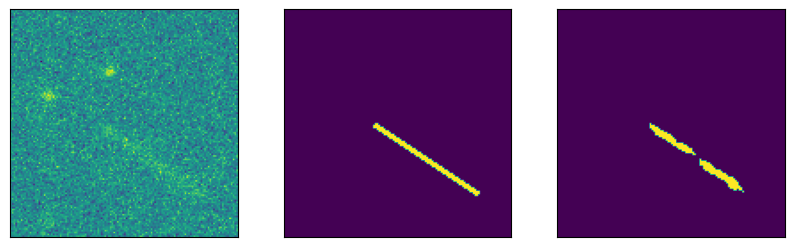

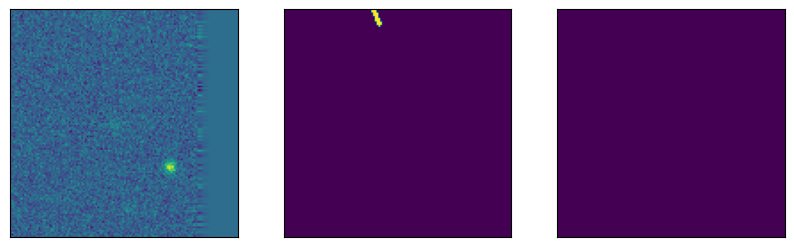

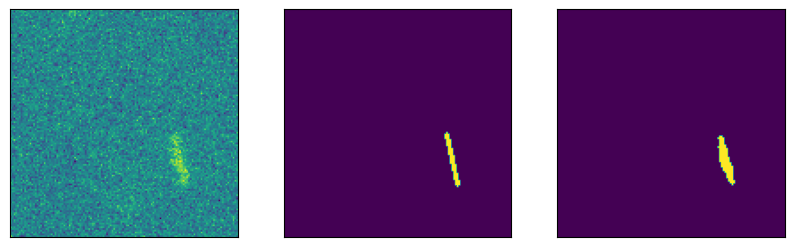

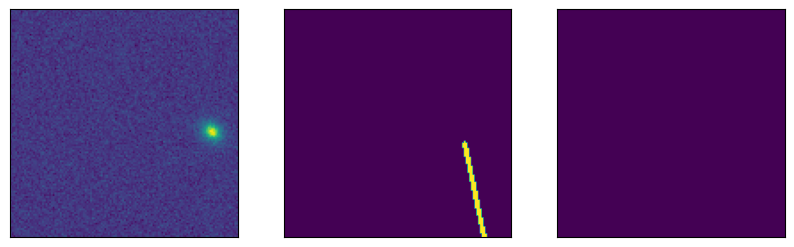

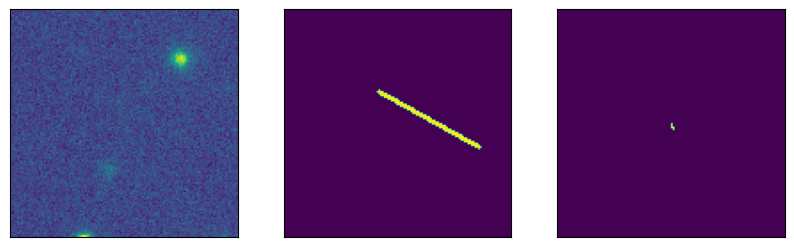

...

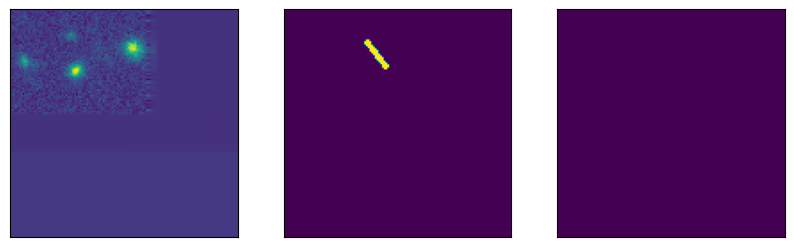

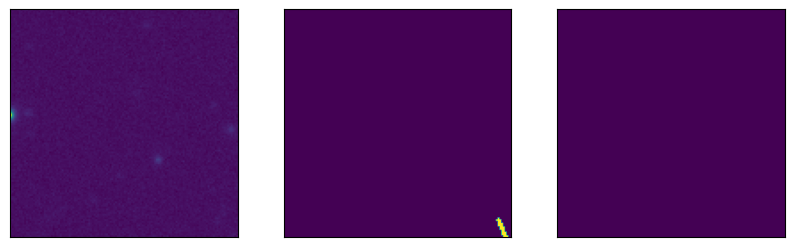

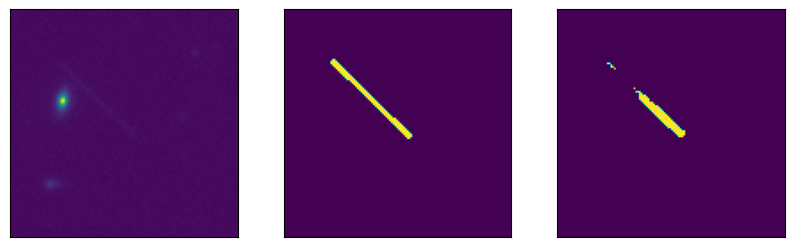

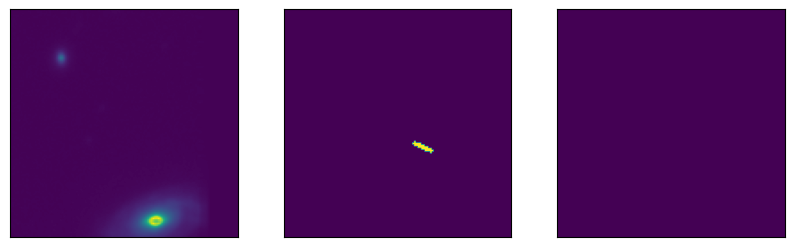

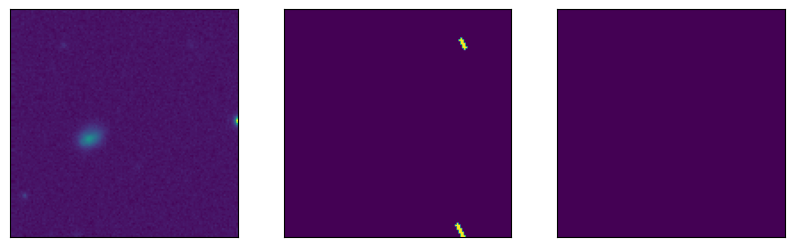


KeyboardInterrupt



In [40]:
for i in np.argwhere((y>0).sum(axis=(1,2,3))!=0).flatten():
    fig, ax = plt.subplots (1, 3, figsize=(10,10))
    ax[0].imshow(x[i])
    ax[1].imshow(y[i])
    ax[2].imshow(p[i]>0.5)
    for k in ax:
        k.set_xticks([])
        k.set_yticks([])
    plt.show()